In [1]:
import tensorflow as tf
from tensorflow.keras import layers, models
from tensorflow.keras.applications import VGG19
from tensorflow.keras.models import Model
import numpy as np
import matplotlib.pyplot as plt
from pathlib import Path
import os
from tqdm.notebook import tqdm

2024-09-05 09:55:04.724647: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.


In [2]:
# Set up paths
base_path = Path.home() / "sar_colorization"
data_path = base_path / "data/v_2"
models_path = base_path / "final_model"
tfrecord_path = data_path / "tfrecords"

# Ensure directories exist
models_path.mkdir(parents=True, exist_ok=True)
tfrecord_path.mkdir(parents=True, exist_ok=True)

In [3]:
# Convert images to TFRecords
def bytes_feature(value):
    """Returns a bytes_list from a string / byte."""
    if isinstance(value, type(tf.constant(0))):
        value = value.numpy()  # Convert from EagerTensor to numpy
    return tf.train.Feature(bytes_list=tf.train.BytesList(value=[value]))

def create_tfrecord(dataset_path, tfrecord_prefix):
    classes = ['agri', 'barrenland', 'grassland', 'urban']
    for land_type in classes:
        s1_path = dataset_path / land_type / 's1'
        s2_path = dataset_path / land_type / 's2'
        
        sar_files = sorted(s1_path.glob('*.png'))
        opt_files = sorted(s2_path.glob('*.png'))
        
        assert len(sar_files) == len(opt_files), "Mismatch between SAR and optical images count."
        
        with tf.io.TFRecordWriter(f"{tfrecord_prefix}_{land_type}.tfrecord") as writer:
            for sar_file, opt_file in tqdm(zip(sar_files, opt_files), total=len(sar_files), desc=f"Converting {land_type} to TFRecords"):
                sar_image = tf.io.read_file(str(sar_file))
                opt_image = tf.io.read_file(str(opt_file))
                
                feature = {
                    'sar_image': bytes_feature(sar_image),
                    'opt_image': bytes_feature(opt_image)
                }
                example = tf.train.Example(features=tf.train.Features(feature=feature))
                writer.write(example.SerializeToString())
        print(f"{land_type.capitalize()} TFRecord conversion complete.")

# Merge TFRecords into a single shuffled TFRecord
def merge_and_shuffle_tfrecords(tfrecord_path, land_types, output_tfrecord_file):
    dataset_list = []
    
    for land_type in land_types:
        tfrecord_file = str(tfrecord_path / f"sar_opt_{land_type}.tfrecord")
        raw_dataset = tf.data.TFRecordDataset(tfrecord_file)
        dataset_list.append(raw_dataset)
    
    merged_dataset = tf.data.Dataset.sample_from_datasets(dataset_list)
    merged_dataset = merged_dataset.shuffle(buffer_size=10000)

    writer = tf.io.TFRecordWriter(output_tfrecord_file)
    for record in tqdm(merged_dataset, desc="Writing merged TFRecord"):
        writer.write(record.numpy())
    writer.close()
    print(f"Shuffled TFRecord file '{output_tfrecord_file}' created successfully.")

In [4]:
# Define the generator (Pix2Pix U-Net with depthwise convolution)
def build_generator():
    initializer = tf.random_normal_initializer(0., 0.02)
    
    def downsample(filters, size, apply_batchnorm=True):
        """Downsampling layer with depthwise separable convolution."""
        result = tf.keras.Sequential()
        result.add(layers.SeparableConv2D(filters, size, strides=2, padding='same',
                                         depthwise_initializer=initializer,
                                         pointwise_initializer=initializer,
                                         use_bias=False))
        if apply_batchnorm:
            result.add(layers.BatchNormalization())
        result.add(layers.LeakyReLU())
        return result

    def upsample(filters, size, apply_dropout=False):
        """Upsampling layer with depthwise separable convolution."""
        result = tf.keras.Sequential()
        result.add(layers.Conv2DTranspose(filters, size, strides=2, padding='same',
                                         kernel_initializer=initializer,
                                         use_bias=False))
        result.add(layers.BatchNormalization())
        if apply_dropout:
            result.add(layers.Dropout(0.5))
        result.add(layers.ReLU())
        return result

    inputs = layers.Input(shape=[256, 256, 1])

    down_stack = [
        downsample(64, 4, apply_batchnorm=False),  # (bs, 128, 128, 64)
        downsample(128, 4),  # (bs, 64, 64, 128)
        downsample(256, 4),  # (bs, 32, 32, 256)
        downsample(512, 4),  # (bs, 16, 16, 512)
        downsample(512, 4),  # (bs, 8, 8, 512)
        downsample(512, 4),  # (bs, 4, 4, 512)
        downsample(512, 4),  # (bs, 2, 2, 512)
        downsample(512, 4),  # (bs, 1, 1, 512)
    ]

    up_stack = [
        upsample(512, 4, apply_dropout=True),  # (bs, 2, 2, 1024)
        upsample(512, 4, apply_dropout=True),  # (bs, 4, 4, 1024)
        upsample(512, 4, apply_dropout=True),  # (bs, 8, 8, 1024)
        upsample(512, 4),  # (bs, 16, 16, 1024)
        upsample(256, 4),  # (bs, 32, 32, 512)
        upsample(128, 4),  # (bs, 64, 64, 256)
        upsample(64, 4),   # (bs, 128, 128, 128)
    ]

    last = layers.Conv2DTranspose(3, 4, strides=2, padding='same',
                                  kernel_initializer=initializer,
                                  activation='tanh')  # (bs, 256, 256, 3)

    x = inputs
    skips = []
    for down in down_stack:
        x = down(x)
        skips.append(x)

    skips = reversed(skips[:-1])

    for up, skip in zip(up_stack, skips):
        x = up(x)
        x = layers.Concatenate()([x, skip])

    x = last(x)

    return models.Model(inputs=inputs, outputs=x)

In [5]:
# Define the multi-scale PatchGAN discriminator
def build_multiscale_patchgan_discriminator():
    initializer = tf.random_normal_initializer(0., 0.02)
    inp = layers.Input(shape=[256, 256, 1], name='input_image')
    tar = layers.Input(shape=[256, 256, 3], name='target_image')
    x = layers.concatenate([inp, tar])

    def discriminator_block(x, filters, size, strides=2, apply_batchnorm=True):
        x = layers.Conv2D(filters, size, strides=strides, padding='same', kernel_initializer=initializer, use_bias=False)(x)
        if apply_batchnorm:
            x = layers.BatchNormalization()(x)
        x = layers.LeakyReLU()(x)
        return x

    down1 = discriminator_block(x, 64, 4, apply_batchnorm=False)
    down2 = discriminator_block(down1, 128, 4)
    down3 = discriminator_block(down2, 256, 4)
    down4 = discriminator_block(down3, 512, 4, strides=1)

    patch_out = layers.Conv2D(1, 4, strides=1, kernel_initializer=initializer)(down4)

    return tf.keras.Model(inputs=[inp, tar], outputs=[patch_out])

In [6]:
# Perceptual Loss using VGG19
def build_vgg19_perceptual_loss():
    vgg = VGG19(include_top=False, weights='imagenet')
    vgg.trainable = False

    content_layers = ['block3_conv3', 'block4_conv3']
    content_model = Model(inputs=vgg.input, outputs=[vgg.get_layer(layer).output for layer in content_layers])
    content_model.trainable = False

    def perceptual_loss(y_true, y_pred):
        y_true_vgg = content_model(y_true)
        y_pred_vgg = content_model(y_pred)
        return tf.reduce_mean([tf.reduce_mean(tf.abs(a - b)) for a, b in zip(y_true_vgg, y_pred_vgg)])
    
    return perceptual_loss

# Define loss functions with Perceptual Loss
def generator_loss(disc_generated_output, gen_output, target, perceptual_loss_fn):
    gan_loss = tf.keras.losses.BinaryCrossentropy(from_logits=True)(tf.ones_like(disc_generated_output), disc_generated_output)
    l1_loss = tf.reduce_mean(tf.abs(target - gen_output))
    perceptual_loss = perceptual_loss_fn(target, gen_output)
    total_gen_loss = gan_loss + (100 * l1_loss) + perceptual_loss
    return total_gen_loss, gan_loss, l1_loss, perceptual_loss

def discriminator_loss(disc_real_output, disc_generated_output):
    real_loss = tf.keras.losses.BinaryCrossentropy(from_logits=True)(tf.ones_like(disc_real_output), disc_real_output)
    generated_loss = tf.keras.losses.BinaryCrossentropy(from_logits=True)(tf.zeros_like(disc_generated_output), disc_generated_output)
    total_disc_loss = real_loss + generated_loss
    return total_disc_loss

In [7]:
# Load TFRecord dataset
def load_tfrecord_dataset(tfrecord_file, batch_size):
    raw_dataset = tf.data.TFRecordDataset(str(tfrecord_file))

    feature_description = {
        'sar_image': tf.io.FixedLenFeature([], tf.string),
        'opt_image': tf.io.FixedLenFeature([], tf.string)
    }

    def parse_function(example_proto):
        parsed_features = tf.io.parse_single_example(example_proto, feature_description)
        sar_image = tf.io.decode_image(parsed_features['sar_image'], channels=1)
        opt_image = tf.io.decode_image(parsed_features['opt_image'], channels=3)
        return tf.cast(sar_image, tf.float32) / 255.0, tf.cast(opt_image, tf.float32) / 255.0

    dataset = raw_dataset.map(parse_function)
    dataset = dataset.shuffle(buffer_size=1024)
    dataset = dataset.batch(batch_size)
    dataset = dataset.prefetch(buffer_size=tf.data.AUTOTUNE)
    return dataset

In [8]:
# Train-test split
def split_dataset(dataset, split_ratio=0.8):
    dataset_size = 0
    for _ in dataset:
        dataset_size += 1
    train_size = int(dataset_size * split_ratio)
    train_dataset = dataset.take(train_size)
    test_dataset = dataset.skip(train_size)
    return train_dataset, test_dataset

In [9]:
# Training loop with accuracy metric
@tf.function
def train_step(input_image, target, generator, discriminator, generator_optimizer, discriminator_optimizer, perceptual_loss_fn):
    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        gen_output = generator(input_image, training=True)
        disc_real_output = discriminator([input_image, target], training=True)
        disc_generated_output = discriminator([input_image, gen_output], training=True)

        gen_total_loss, gen_gan_loss, gen_l1_loss, perceptual_loss = generator_loss(disc_generated_output, gen_output, target, perceptual_loss_fn)
        disc_loss = discriminator_loss(disc_real_output, disc_generated_output)

        generator_gradients = gen_tape.gradient(gen_total_loss, generator.trainable_variables)
        discriminator_gradients = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

        generator_optimizer.apply_gradients(zip(generator_gradients, generator.trainable_variables))
        discriminator_optimizer.apply_gradients(zip(discriminator_gradients, discriminator.trainable_variables))

    return gen_total_loss, disc_loss, gen_output, perceptual_loss

def calculate_accuracy(target, gen_output):
    psnr = tf.reduce_mean(tf.image.psnr(target, gen_output, max_val=1.0))
    ssim = tf.reduce_mean(tf.image.ssim(target, gen_output, max_val=1.0))
    return psnr, ssim

In [10]:
def train(dataset, epochs, checkpoint_dir):
    generator = build_generator()
    discriminator = build_multiscale_patchgan_discriminator()

    generator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
    discriminator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

    perceptual_loss_fn = build_vgg19_perceptual_loss()

    # Create checkpoint manager to save and restore models
    checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
    checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                      discriminator_optimizer=discriminator_optimizer,
                                      generator=generator,
                                      discriminator=discriminator)
    checkpoint_manager = tf.train.CheckpointManager(checkpoint, checkpoint_dir, max_to_keep=5)

    # Restore the latest checkpoint if it exists
    if checkpoint_manager.latest_checkpoint:
        print(f"Restoring from checkpoint: {checkpoint_manager.latest_checkpoint}")
        checkpoint.restore(checkpoint_manager.latest_checkpoint)
        # Extract the epoch number from the checkpoint file
        initial_epoch = int(checkpoint_manager.latest_checkpoint.split('-')[-1])
    else:
        print("Starting training from scratch.")
        initial_epoch = 0

    for epoch in range(initial_epoch, epochs):
        print(f"Epoch {epoch + 1}/{epochs}")
        progress_bar = tqdm(dataset, desc=f"Epoch {epoch + 1}/{epochs}", unit="batch")

        for n, (input_image, target) in enumerate(progress_bar):
            gen_total_loss, disc_loss, gen_output, perceptual_loss = train_step(input_image, target, generator, discriminator, generator_optimizer, discriminator_optimizer, perceptual_loss_fn)
            psnr, ssim = calculate_accuracy(target, gen_output)
            progress_bar.set_postfix(gen_loss=f"{gen_total_loss:.4f}", disc_loss=f"{disc_loss:.4f}", psnr=f"{psnr:.4f}", ssim=f"{ssim:.4f}")

        # Save the model every 5 epochs
        if (epoch + 1) % 5 == 0:
            checkpoint_manager.save(checkpoint_number=epoch + 1)
            print(f"Checkpoint saved at epoch {epoch + 1}")

        # Display image pairs
        visualize_generated_images(input_image, target, gen_output)

    return generator  # Return the trained generator


In [11]:
# Visualize SAR and Optical Images
def visualize_images(dataset):
    for sar_image, opt_image in dataset.take(1):
        fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 6))

        ax1.imshow(sar_image[0, :, :, 0], cmap='gray')
        ax1.set_title('SAR Image')
        ax1.axis('off')

        ax2.imshow(opt_image[0, :, :, :])
        ax2.set_title('Optical Image')
        ax2.axis('off')

        plt.show()

# Visualize Generated Images
def visualize_generated_images(sar_image, opt_image, gen_output):
    fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(18, 6))

    ax1.imshow(sar_image[0, :, :, 0], cmap='gray')
    ax1.set_title('SAR Image')
    ax1.axis('off')

    ax2.imshow(opt_image[0, :, :, :])
    ax2.set_title('Optical Image (True)')
    ax2.axis('off')

    ax3.imshow(gen_output[0, :, :, :])
    ax3.set_title('Optical Image (Generated)')
    ax3.axis('off')

    plt.show()

In [12]:
# Generate optical images for test data
def generate_optical_images(generator, test_dataset):
    for sar_image, opt_image in test_dataset:
        gen_output = generator(sar_image, training=False)
        visualize_generated_images(sar_image, opt_image, gen_output)


2024-09-05 09:55:07.588012: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:984] could not open file to read NUMA node: /sys/bus/pci/devices/0000:01:00.0/numa_node
Your kernel may have been built without NUMA support.
2024-09-05 09:55:07.639763: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:984] could not open file to read NUMA node: /sys/bus/pci/devices/0000:01:00.0/numa_node
Your kernel may have been built without NUMA support.
2024-09-05 09:55:07.639808: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:984] could not open file to read NUMA node: /sys/bus/pci/devices/0000:01:00.0/numa_node
Your kernel may have been built without NUMA support.
2024-09-05 09:55:07.642303: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:984] could not open file to read NUMA node: /sys/bus/pci/devices/0000:01:00.0/numa_node
Your kernel may have been built without NUMA support.
2024-09-05 09:55:07.642341: I external/local_xla/xla/stream_executor

Writing merged TFRecord: 0it [00:00, ?it/s]

2024-09-05 09:55:23.400681: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Shuffled TFRecord file '/home/omm/sar_colorization/data/v_2/tfrecords/sar_opt_all_shuffled.tfrecord' created successfully.


2024-09-05 09:55:34.942496: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


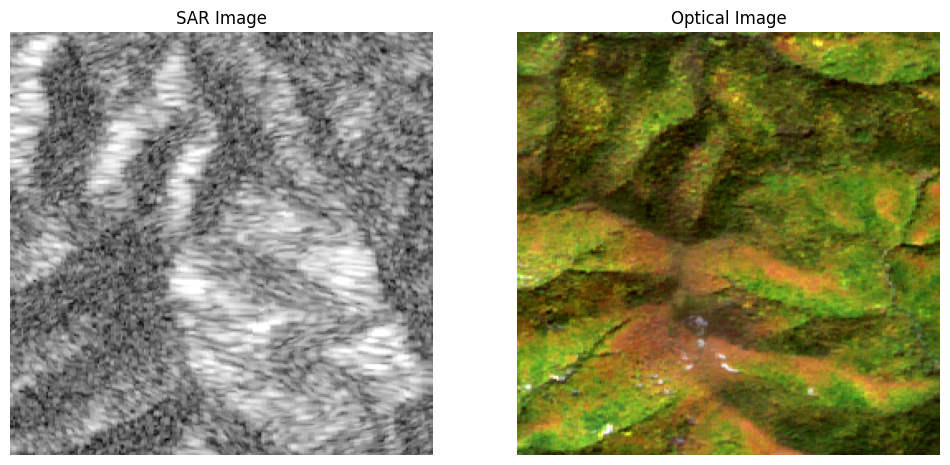

2024-09-05 09:55:36.298509: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Restoring from checkpoint: /home/omm/sar_colorization/final_model/ckpt-15
Epoch 16/100


Epoch 16/100: 0batch [00:00, ?batch/s]

2024-09-05 09:55:48.087719: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape infunctional_15_1/sequential_8_1/dropout_1/stateless_dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer
2024-09-05 09:55:48.818989: I external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:465] Loaded cuDNN version 8907
2024-09-05 09:55:51.453376: W external/local_tsl/tsl/framework/bfc_allocator.cc:296] Allocator (GPU_0_bfc) ran out of memory trying to allocate 4.17GiB with freed_by_count=0. The caller indicates that this is not a failure, but this may mean that there could be performance gains if more memory were available.
2024-09-05 10:05:42.779220: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [

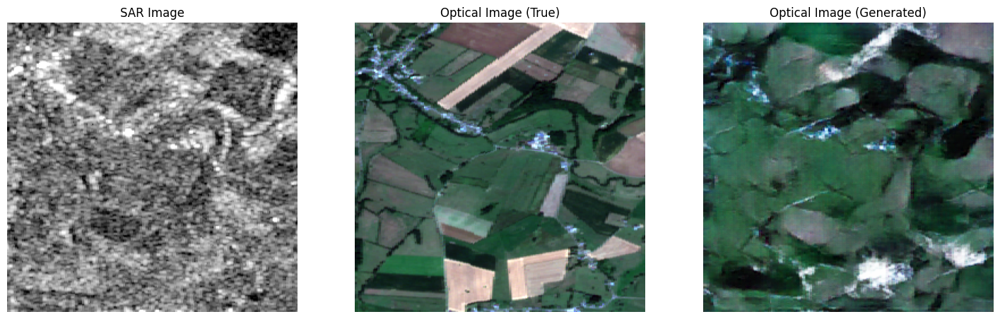

Epoch 17/100


Epoch 17/100: 0batch [00:00, ?batch/s]

2024-09-05 10:15:28.204677: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.06682588..1.0].


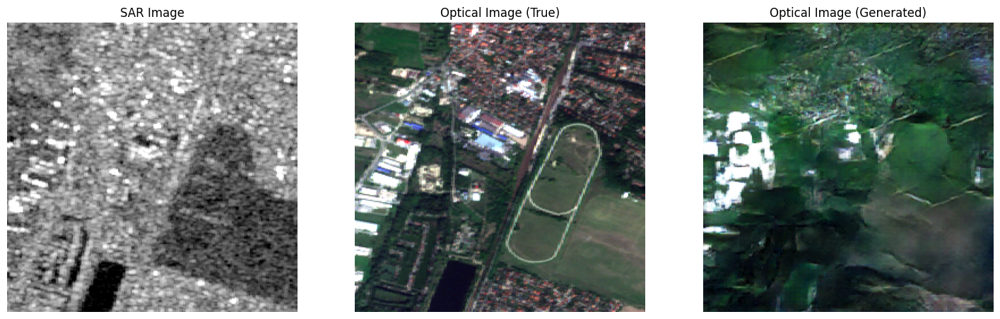

Epoch 18/100


Epoch 18/100: 0batch [00:00, ?batch/s]

2024-09-05 10:25:18.872957: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.29646483..1.0].


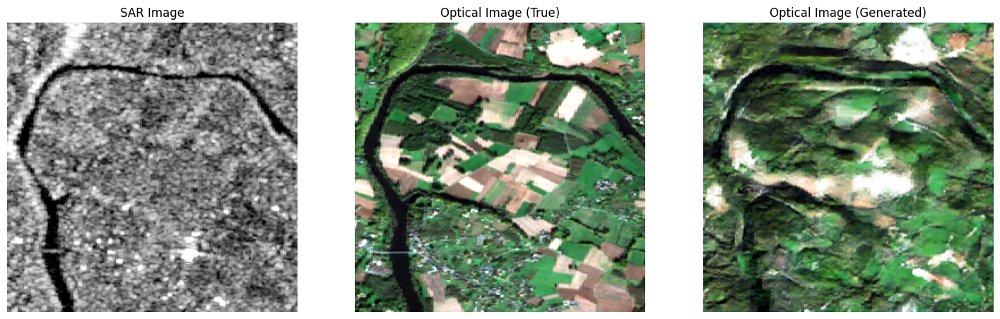

Epoch 19/100


Epoch 19/100: 0batch [00:00, ?batch/s]

2024-09-05 10:35:04.865551: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.07660111..0.9962291].


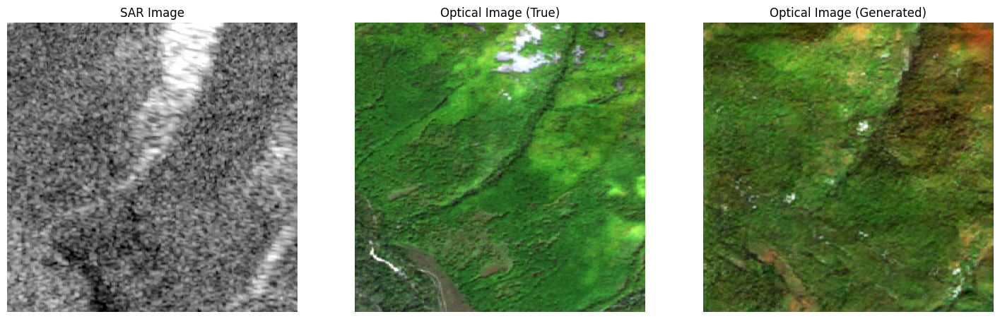

Epoch 20/100


Epoch 20/100: 0batch [00:00, ?batch/s]

2024-09-05 10:44:55.070126: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Checkpoint saved at epoch 20


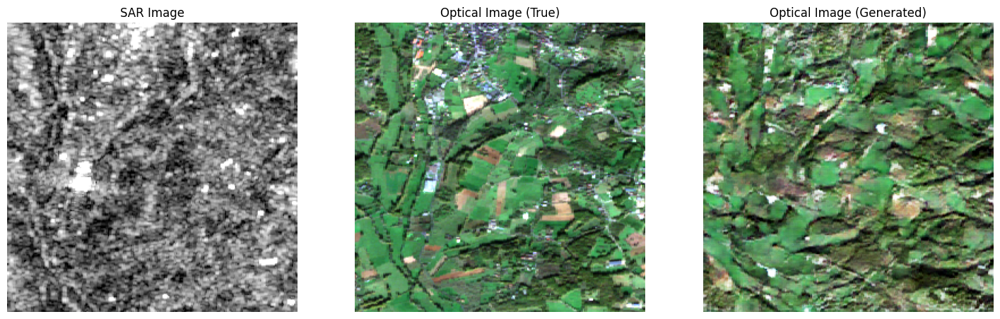

Epoch 21/100


Epoch 21/100: 0batch [00:00, ?batch/s]

2024-09-05 10:54:44.887047: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


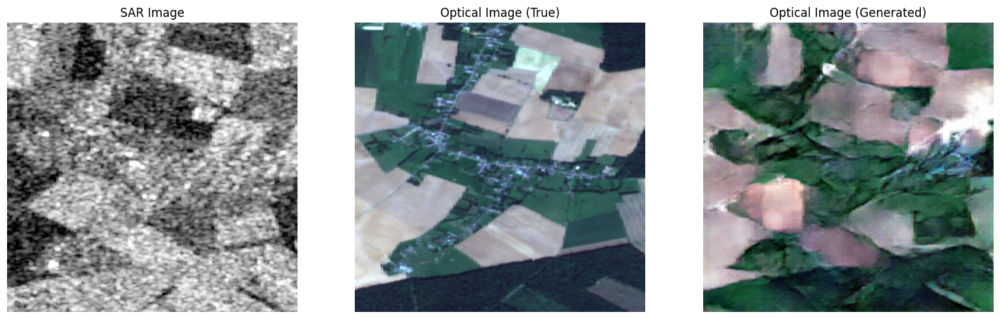

Epoch 22/100


Epoch 22/100: 0batch [00:00, ?batch/s]

2024-09-05 11:04:30.503301: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


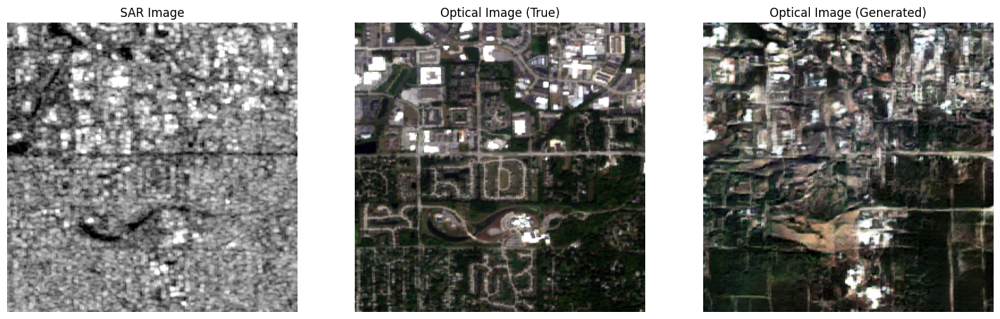

Epoch 23/100


Epoch 23/100: 0batch [00:00, ?batch/s]

2024-09-05 11:14:19.302266: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


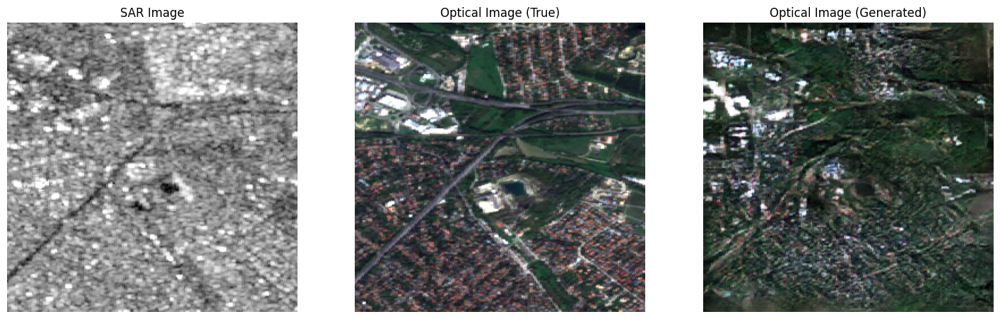

Epoch 24/100


Epoch 24/100: 0batch [00:00, ?batch/s]

2024-09-05 11:24:05.748968: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


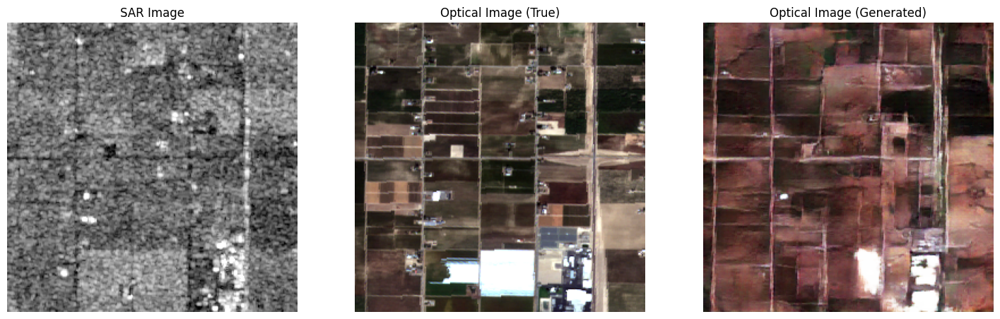

Epoch 25/100


Epoch 25/100: 0batch [00:00, ?batch/s]

2024-09-05 11:33:52.087881: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Checkpoint saved at epoch 25


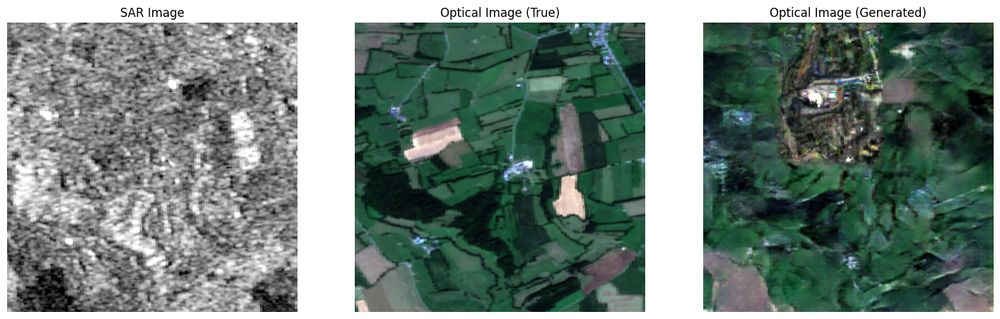

Epoch 26/100


Epoch 26/100: 0batch [00:00, ?batch/s]

2024-09-05 11:43:42.027041: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


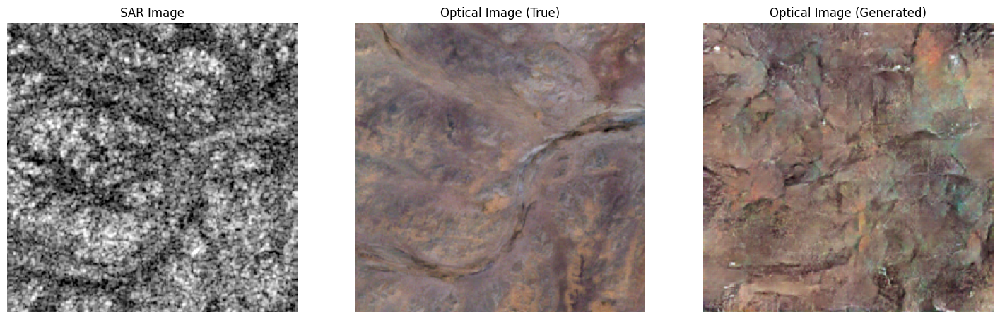

Epoch 27/100


Epoch 27/100: 0batch [00:00, ?batch/s]

2024-09-05 11:53:28.178782: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


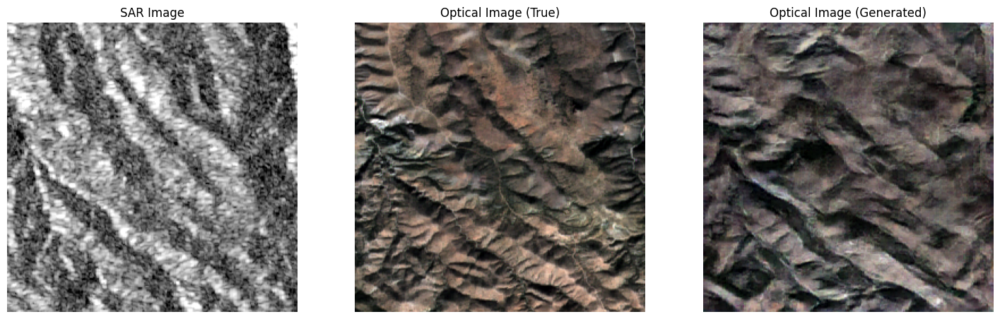

Epoch 28/100


Epoch 28/100: 0batch [00:00, ?batch/s]

2024-09-05 12:03:18.213422: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


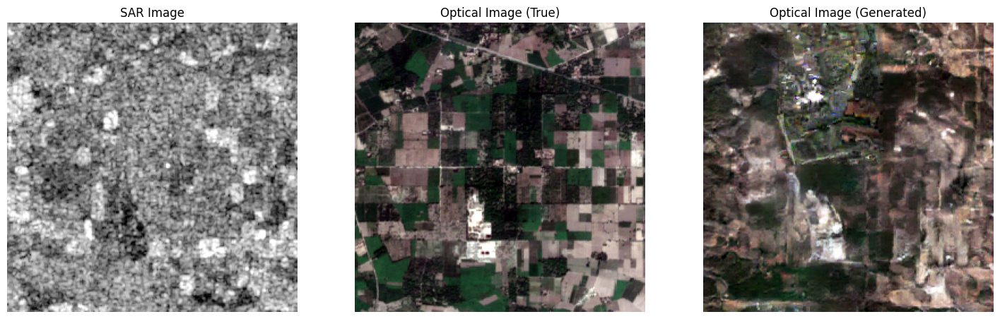

Epoch 29/100


Epoch 29/100: 0batch [00:00, ?batch/s]

2024-09-05 12:13:04.766525: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


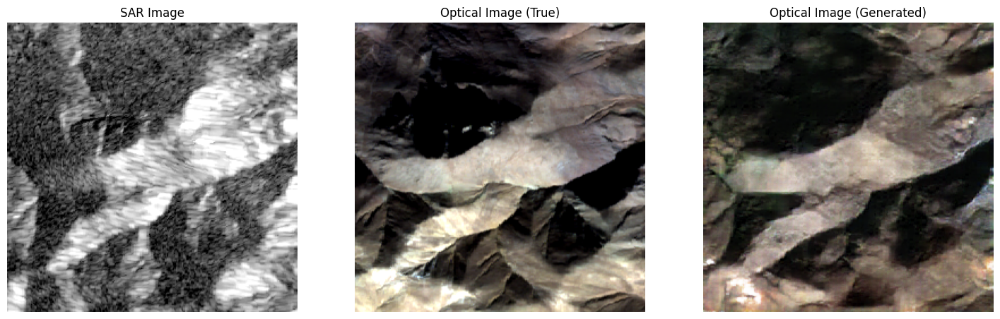

Epoch 30/100


Epoch 30/100: 0batch [00:00, ?batch/s]

2024-09-05 12:22:50.825919: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Checkpoint saved at epoch 30


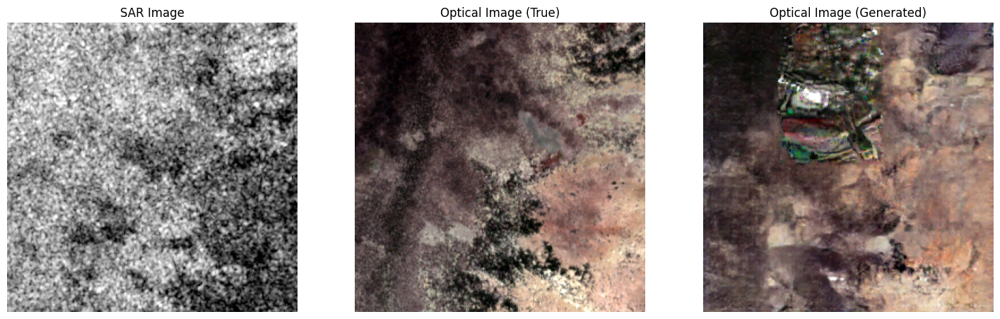

Epoch 31/100


Epoch 31/100: 0batch [00:00, ?batch/s]

2024-09-05 12:32:41.673042: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


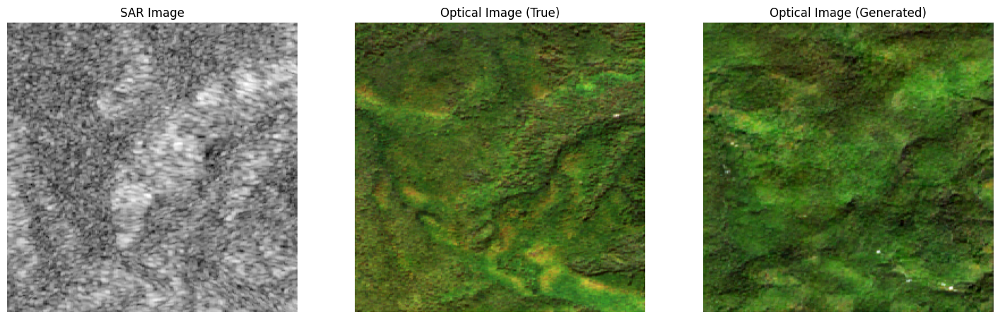

Epoch 32/100


Epoch 32/100: 0batch [00:00, ?batch/s]

2024-09-05 12:42:31.415880: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


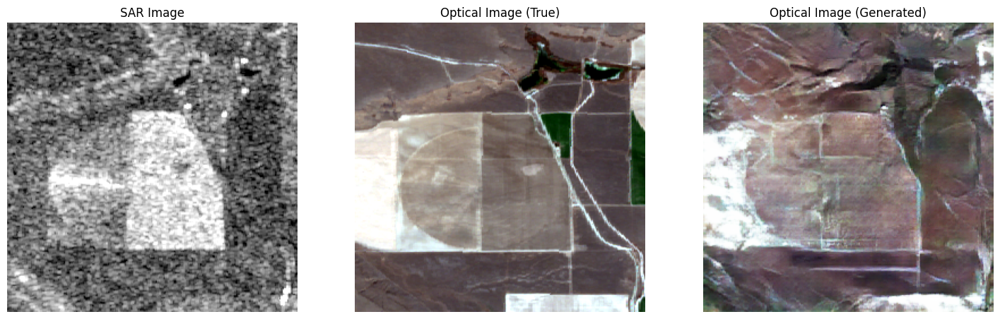

Epoch 33/100


Epoch 33/100: 0batch [00:00, ?batch/s]

2024-09-05 12:52:41.297432: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


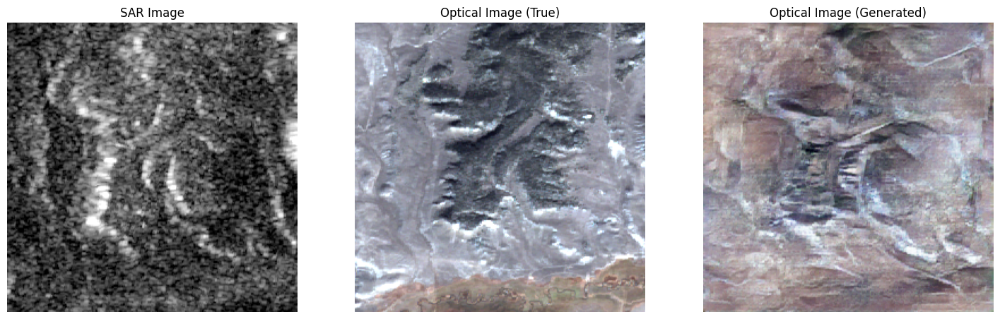

Epoch 34/100


Epoch 34/100: 0batch [00:00, ?batch/s]

2024-09-05 13:03:00.536325: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


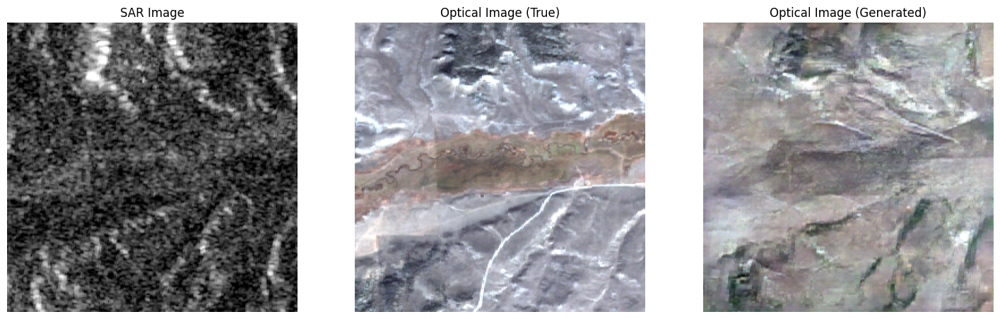

Epoch 35/100


Epoch 35/100: 0batch [00:00, ?batch/s]

2024-09-05 13:13:20.948792: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Checkpoint saved at epoch 35


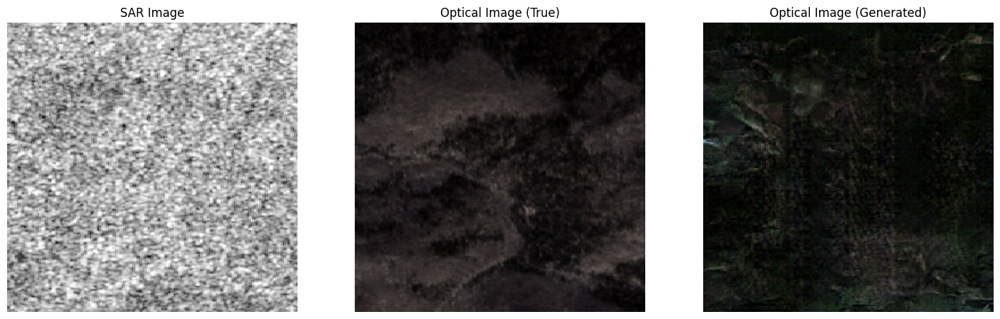

Epoch 36/100


Epoch 36/100: 0batch [00:00, ?batch/s]

2024-09-05 13:23:41.037398: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


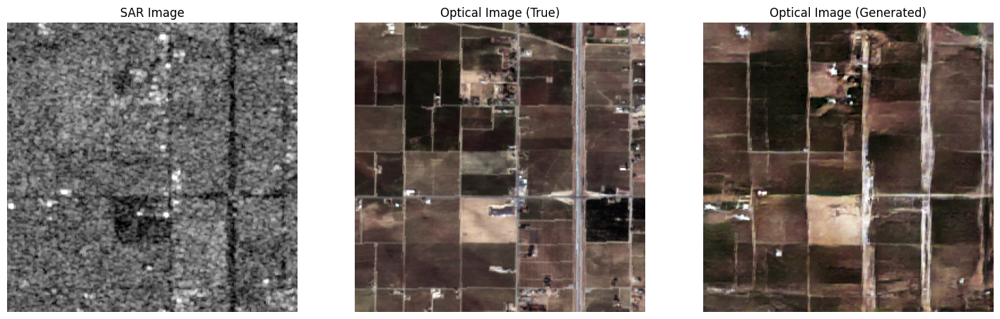

Epoch 37/100


Epoch 37/100: 0batch [00:00, ?batch/s]

2024-09-05 13:34:00.826132: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


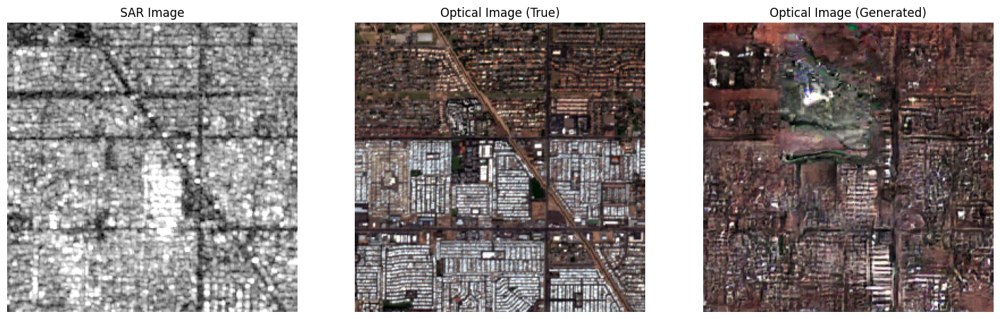

Epoch 38/100


Epoch 38/100: 0batch [00:00, ?batch/s]

2024-09-05 13:44:16.197247: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


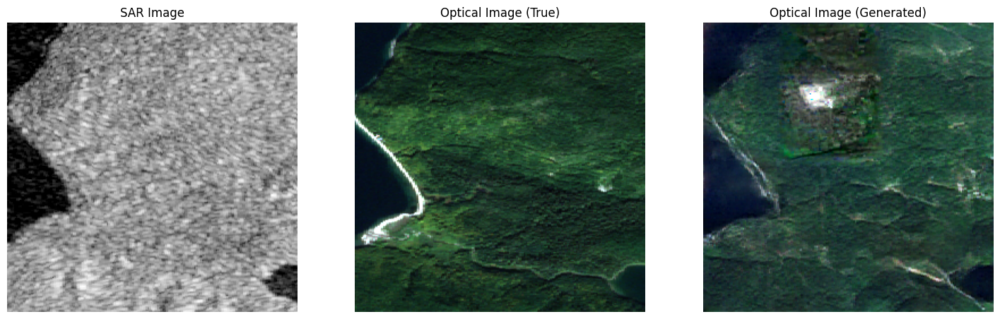

Epoch 39/100


Epoch 39/100: 0batch [00:00, ?batch/s]

In [ ]:
# Main execution
if __name__ == "__main__":
    BATCH_SIZE = 4
    EPOCHS = 100

    # Convert images to TFRecords
    # create_tfrecord(data_path, str(tfrecord_path / "sar_opt"))

    # Land types
    land_types = ['agri', 'barrenland', 'grassland', 'urban']

    # Merge and shuffle TFRecords
    merged_tfrecord_file = str(tfrecord_path / "sar_opt_all_shuffled.tfrecord")
    merge_and_shuffle_tfrecords(tfrecord_path, land_types, merged_tfrecord_file)

    # Load the shuffled dataset
    dataset = load_tfrecord_dataset(merged_tfrecord_file, BATCH_SIZE)

    # Train-test split
    train_dataset, test_dataset = split_dataset(dataset, split_ratio=0.8)

    # Visualize the first pair of SAR and Optical images
    visualize_images(train_dataset)

    # Train the model
    trained_generator = train(train_dataset, EPOCHS, models_path)

    # Generate optical images for all the test data
    generate_optical_images(trained_generator, test_dataset)